In [ ]:
!pip install pretrained-backbones-unet monai

import torch
from backbones_unet.model.unet import Unet
from monai.transforms import (
    Compose, LoadImage, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType
)
from monai.visualize import plot_2d_or_3d_image

# Load pre-trained UNet model with a specific backbone
model = Unet(
    backbone='resnet34',  # or any other supported backbone
    in_channels=3,
    num_classes=1,
    pretrained=True  # Use pre-trained weights
).to("cuda")

# Preprocess the image
image = LoadImage()(filename='/content/image.jpg')
transform = Compose([EnsureChannelFirst(), ScaleIntensity(), ToTensor(), EnsureType()])
image = transform(image)
image = image.unsqueeze(0).to("cuda")

# Predict the mask
with torch.no_grad():
    output = model(image)
    output = (output.sigmoid() > 0.5).float()

# Visualize the result
plot_2d_or_3d_image(image, 0, cmap="gray", title="Input Image")
plot_2d_or_3d_image(output, 0, cmap="gray", title="Predicted Mask")


In [ ]:
!pip install segmentation-models-pytorch monai

import segmentation_models_pytorch as smp
import torch
from monai.transforms import (
    Compose, LoadImage, EnsureChannelFirst, ScaleIntensity, Resize, ToTensor, EnsureType
)
import matplotlib.pyplot as plt

# Load pre-trained U-Net model with a ResNet34 backbone
model = smp.Unet(
    encoder_name="resnet34",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use pre-trained weights for encoder
    in_channels=3,                  # model input channels (1 for gray-scale, 3 for RGB, etc.)
    classes=1,                      # model output channels (number of classes)
).to("cuda")

# Preprocess the image
image_path = 'path_to_your_image.jpg'  # Update this path to your image
image = LoadImage()(filename=image_path)
transform = Compose([
    EnsureChannelFirst(),
    ScaleIntensity(),
    Resize((256, 256)),  # Resize image to 256x256, you can adjust this size as needed
    ToTensor(),
    EnsureType()
])
image = transform(image)
image = image.unsqueeze(0).to("cuda")

# Predict the mask
model.eval()
with torch.no_grad():
    output = model(image)
    output = (output.sigmoid() > 0.5).float()

# Convert tensors to numpy arrays for visualization
image_np = image.cpu().numpy()[0].transpose(1, 2, 0)
output_np = output.cpu().numpy()[0, 0]

# Visualize the result using Matplotlib
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image_np, cmap="gray")
plt.title("Input Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(output_np, cmap="gray")
plt.title("Predicted Mask")
plt.axis('off')

plt.show()


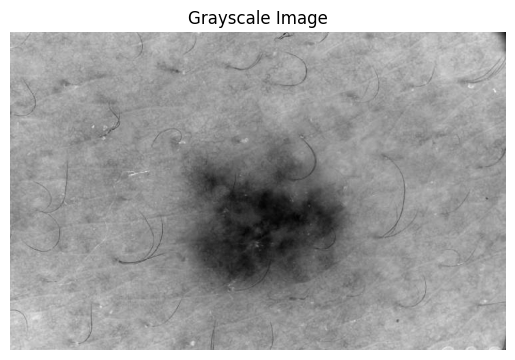

In [19]:
import cv2
import matplotlib.pyplot as plt

# Load the image
image = cv2.imread('/content/ISIC_0708678.JPG')

# Convert to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Display the result
plt.imshow(gray_image, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')
plt.show()


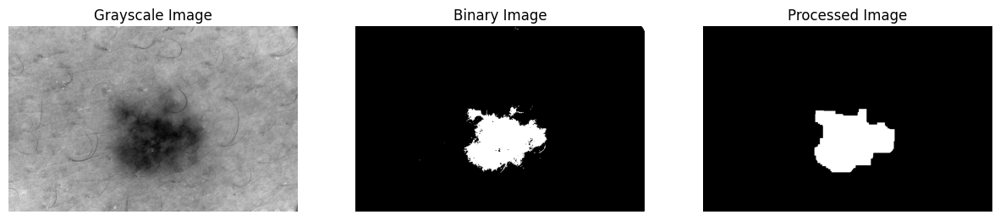

In [36]:
import numpy as np

# Apply a binary threshold to turn the darkest areas white and the rest black
_, binary_image = cv2.threshold(gray_image, 80, 255, cv2.THRESH_BINARY_INV)

# Apply morphological operations to focus on areas rather than single pixels
# Use closing to fill small holes inside the foreground regions
kernel = np.ones((20, 20), np.uint8)
closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)

# Use opening to remove noise
opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

# Display the results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(gray_image, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title('Binary Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(opened_image, cmap='gray')
plt.title('Processed Image')
plt.axis('off')

plt.show()


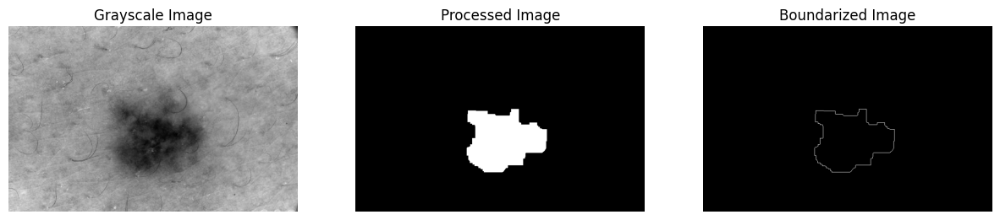

In [37]:
# Find contours of the binary image
contours, _ = cv2.findContours(opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Create an empty image to draw contours
contour_image = np.zeros_like(opened_image)

# Draw contours on the empty image
cv2.drawContours(contour_image, contours, -1, (255, 255, 255), 1)  # White contours with thickness of 1

# Display the result with contours
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(gray_image, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(opened_image, cmap='gray')
plt.title('Processed Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(contour_image, cmap='gray')
plt.title('Boundarized Image')
plt.axis('off')

plt.show()


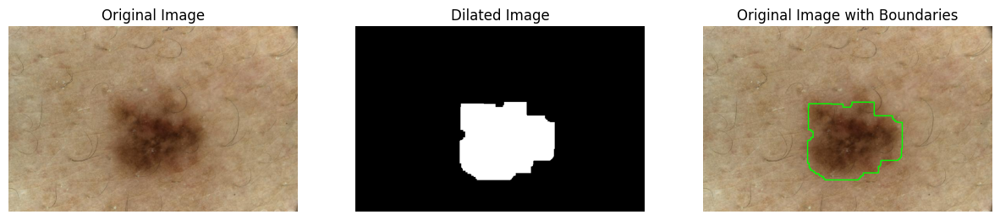

In [38]:
# Dilate the image to enlarge the area of the regions
dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

# Find contours of the dilated image
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw contours on the original image
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Green contours with thickness of 2

# Display the results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(dilated_image, cmap='gray')
plt.title('Dilated Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.title('Original Image with Boundaries')
plt.axis('off')

plt.show()


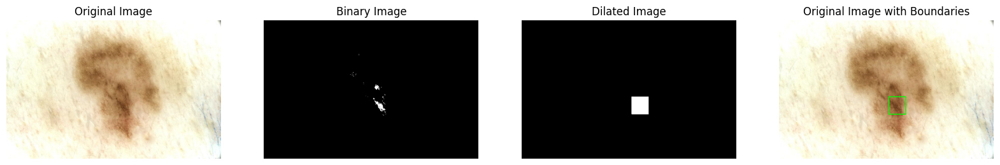

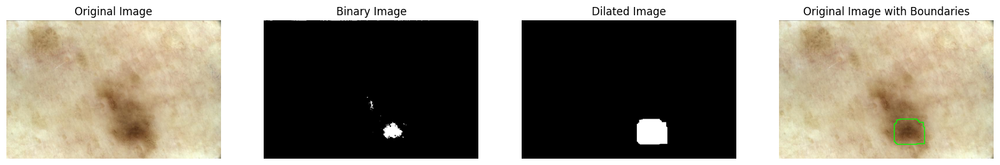

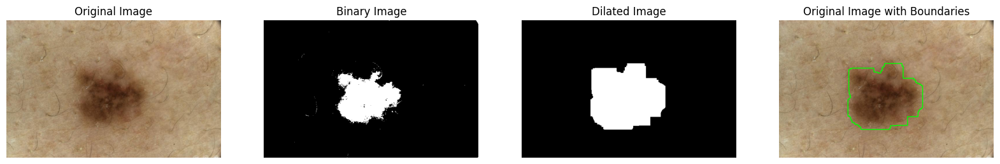

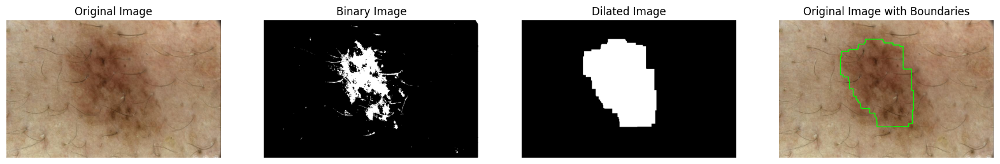

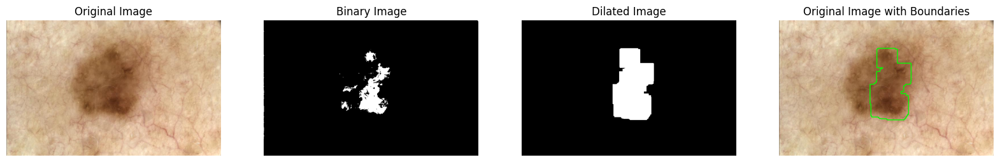

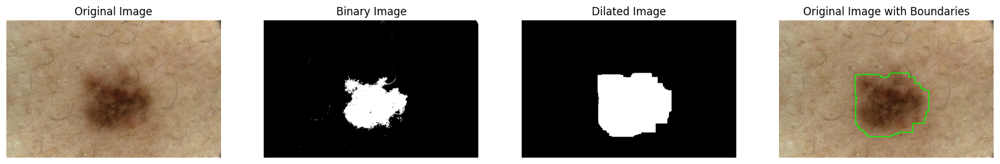

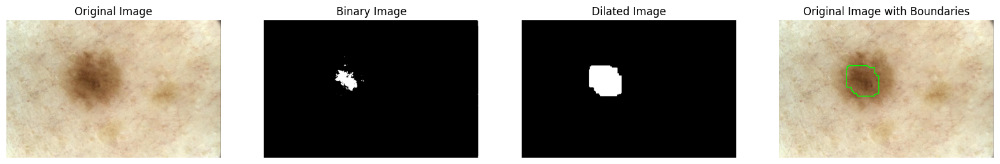

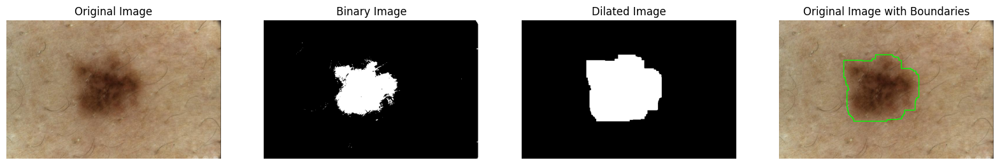

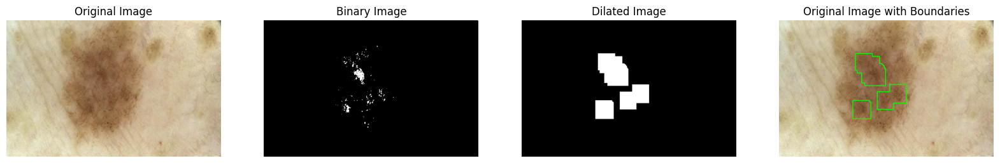

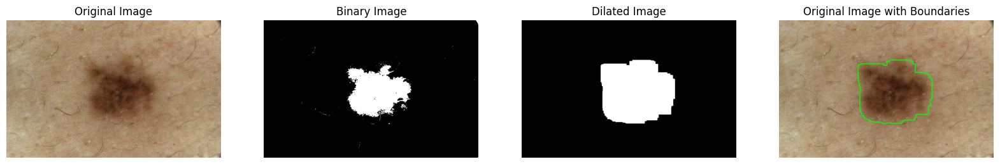

Processing and saving of images completed.


In [50]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ensure results directory exists
results_dir = '/content/results'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((20, 20), np.uint8)

# Process each image in the /content/images/ directory
images_dir = '/content/images'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Convert to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply a binary threshold to turn the darkest areas white and the rest black
        _, binary_image = cv2.threshold(gray_image, 90, 255, cv2.THRESH_BINARY_INV)  # Lower threshold to 30

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Find contours of the dilated image
        contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw contours on the original image
        image_with_contours = image.copy()
        cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Green contours with thickness of 2

        # Display the results and save them to the results directory
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 4, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(binary_image, cmap='gray')
        plt.title('Binary Image')
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(dilated_image, cmap='gray')
        plt.title('Dilated Image')
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Original Image with Boundaries')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ensure results directory exists
results_dir = '/content/results'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((15, 15), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

# Process each image in the /content/images/ directory
images_dir = '/content/images'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Apply a binary threshold to turn the darkest areas white and the rest black
        _, binary_image = cv2.threshold(gray_image, 47, 255, cv2.THRESH_BINARY_INV)  # Lower threshold to 30

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Find contours of the dilated image
        contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw contours on the original image
        image_with_contours = image.copy()
        cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Green contours with thickness of 2

        # Display the results and save them to the results directory
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 5, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 5, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 5, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 5, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 5, 5)
        plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Final with Boundaries')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


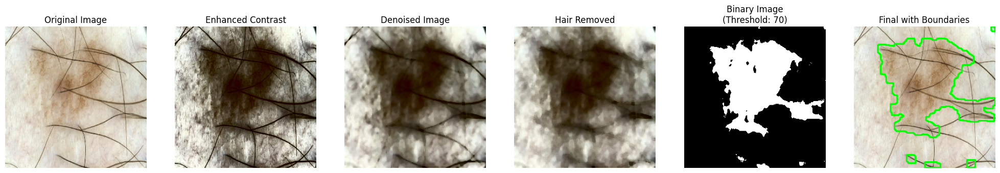

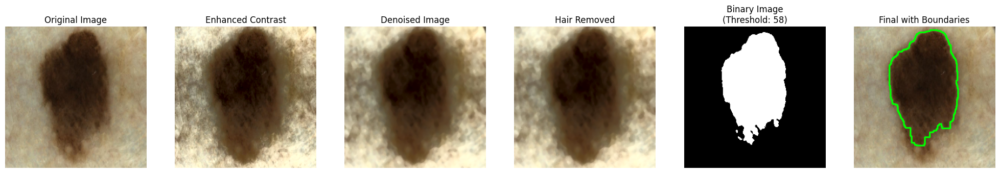

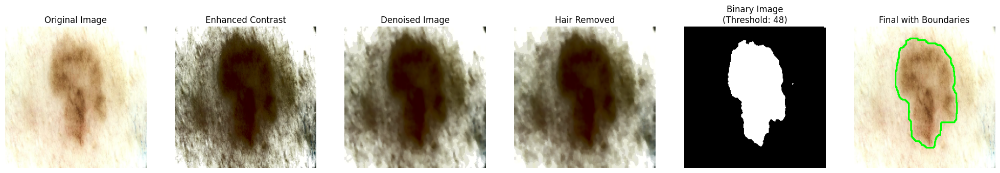

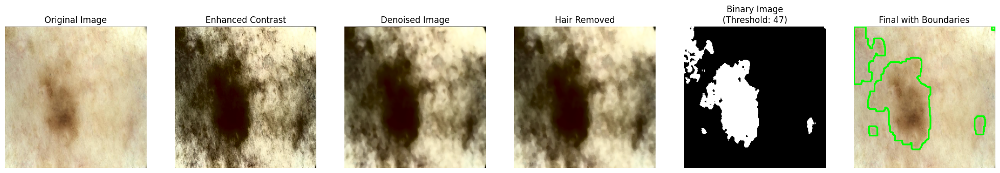

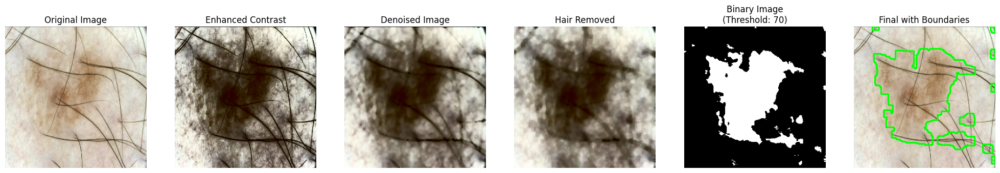

...

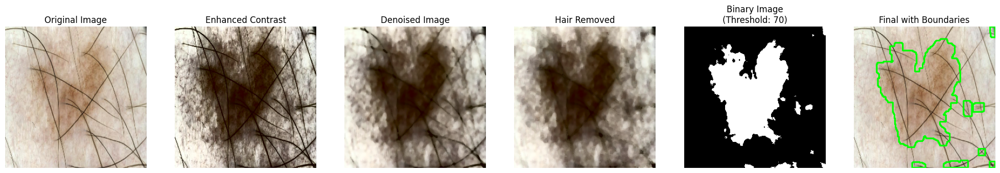

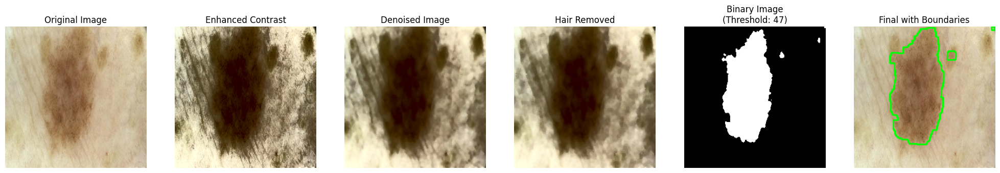

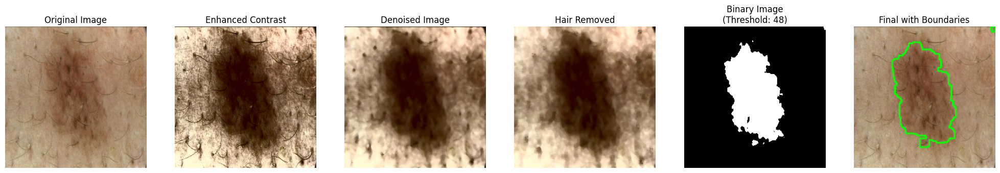

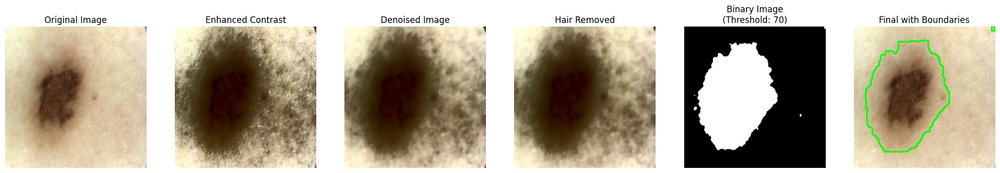

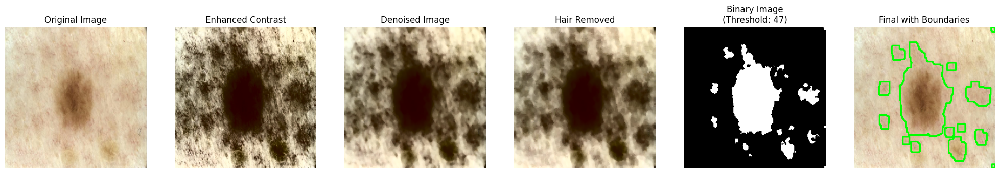

Processing and saving of images completed.


In [23]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ensure results directory exists
results_dir = '/content/results-del'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

def calculate_adaptive_threshold(gray_image, min_threshold=40, max_threshold=70, adjustment_factor=35):
    """
    Calculate adaptive threshold based on the darkest part of the image with min and max limits.

    Parameters:
    - gray_image: Grayscale image for which to calculate the threshold.
    - min_threshold: Minimum threshold value.
    - max_threshold: Maximum threshold value.
    - adjustment_factor: Factor to adjust the threshold based on the darkest part.

    Returns:
    - threshold_value: Calculated threshold value.
    """
    # Calculate histogram
    hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    # Find the darkest part
    darkest = np.where(hist == np.max(hist[:128]))[0][0]
    # Set the threshold closer to the darkest part with limits
    threshold_value = darkest + adjustment_factor
    threshold_value = max(min_threshold, min(threshold_value, max_threshold))
    return threshold_value


# Process each image in the /content/images/ directory
images_dir = '/content/images'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold based on the adaptive threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Find contours of the dilated image
        contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw contours on the original image
        image_with_contours = image.copy()
        cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Green contours with thickness of 2

        # Display the results and save them to the results directory
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 6, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 6, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 6, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 6, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 6, 5)
        plt.imshow(binary_image, cmap='gray')
        plt.title(f'Binary Image\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 6, 6)
        plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Final with Boundaries')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


In [25]:
import shutil

# Zip the results folder
shutil.make_archive('/content/results-resized', 'zip', '/content/results-del')

from google.colab import files

# Download the zipped results folder
files.download('/content/results-resized.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>